In [1]:
!pip install torchsummary

In [2]:
import os
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [3]:
# Дирректория с изображениями
dataroot = "/kaggle/input/celeba-dataset/img_align_celeba"

# Размер батча
batch_size = 256

# Количество шагов
n_steps = 10000 # очень большое число, чтобы выбрать весь датасет


# Размер входа сети для изображений. Все изображения ресайзятся к нему
image_size = 128

# Количество каналов цвета
nc = 3

# Размер латентного вектора (размерность латентного пространства)
nz = 100

# Рамер карты признаков для дискриминатора
ndf = 32

# Кол-во эпох
num_epochs = 20

# Лернингрейт
lr = 0.0002

# Параметр для оптимизатора Adam
beta1 = 0.5

# Количество GPU, 0 если считаем на CPU
ngpu = 1

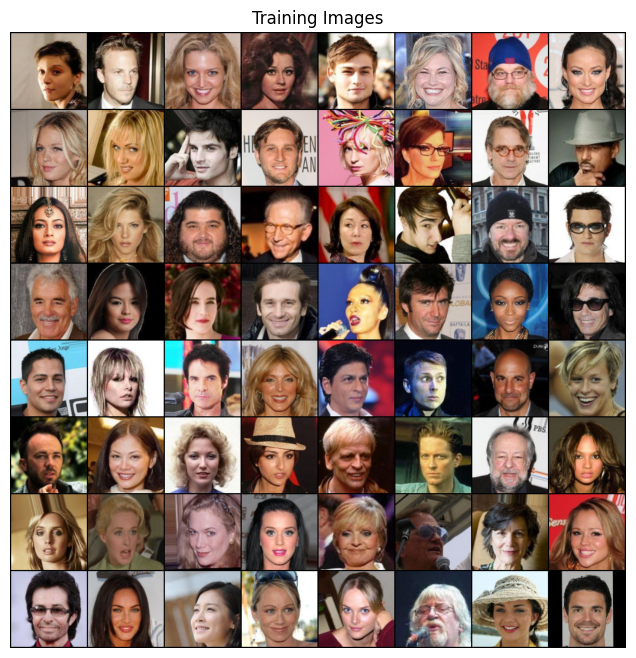

In [4]:
# Для создания датасета используем класс ImageFolder
# Создаем датасет
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
dataset = torch.utils.data.Subset(dataset, range(min(len(dataset), batch_size * n_steps)))

# Создаем даталоадер
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Выбираем девайс для вычислений
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Нарисуем часть картинок из датасета
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [5]:
# кастомная инициализация весов netG или netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [6]:
class CSPup(torch.nn.Module):
    def __init__(self, d_in, d_out):
        super(CSPup, self).__init__()
        self.conv1 = nn.Conv2d(d_out, d_out, 1, 1, 0, bias=False)
        self.conv2 = nn.Conv2d(d_out, d_out, 3, 1, 1, bias=False)
        self.conv3 = nn.Conv2d(d_out, d_out, 3, 1, 1, bias=False)
        self.deconv1 = nn.ConvTranspose2d(d_out, d_out, 4, 2, 1, bias=False)
        self.deconv2 = nn.ConvTranspose2d(d_out, d_out, 4, 2, 1, bias=False)
        self.relu1 = nn.ReLU(True)
        self.relu2 = nn.ReLU(True)
        self.bn1 = nn.BatchNorm2d(d_out)
        self.bn2 = nn.BatchNorm2d(d_out)
        
    def forward(self, x):
        x1, x2 = torch.tensor_split(x, 2, 1)
        x1 = self.deconv1(x1)

        x2 = self.conv1(x2)
        x2 = self.relu1(x2)
        x2 = self.bn1(x2)
        x2 = self.deconv2(x2)
        x2 = self.conv2(x2)
        x2 = self.relu2(x2)
        x2 = self.bn1(x2)
        x2 = self.conv3(x2)

        return x1 + x2

In [7]:
# Имплементация генератора
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d(100, 2048, 4, 1, 0, bias=False),
            nn.BatchNorm2d(2048),
            nn.ReLU(True),
            *[CSPup(koef*2, koef) for koef in [1024, 512, 256, 128]],
            nn.ConvTranspose2d(128, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Инициализируем генератор
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Инициализируем веса
netG.apply(weights_init)

from torchsummary import summary

summary(netG, (100, 1, 1))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1           [-1, 2048, 4, 4]       3,276,800
       BatchNorm2d-2           [-1, 2048, 4, 4]           4,096
              ReLU-3           [-1, 2048, 4, 4]               0
   ConvTranspose2d-4           [-1, 1024, 8, 8]      16,777,216
            Conv2d-5           [-1, 1024, 4, 4]       1,048,576
              ReLU-6           [-1, 1024, 4, 4]               0
       BatchNorm2d-7           [-1, 1024, 4, 4]           2,048
   ConvTranspose2d-8           [-1, 1024, 8, 8]      16,777,216
            Conv2d-9           [-1, 1024, 8, 8]       9,437,184
             ReLU-10           [-1, 1024, 8, 8]               0
      BatchNorm2d-11           [-1, 1024, 8, 8]           2,048
           Conv2d-12           [-1, 1024, 8, 8]       9,437,184
            CSPup-13           [-1, 1024, 8, 8]               0
  ConvTranspose2d-14          [-1, 512,

In [9]:
# Имплементация дискриминатора

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 128 x 128
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 64 x 64
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 32 x 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 16 x 16
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 8 x 8
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*16) x 4 x 4
            nn.Conv2d(ndf * 16, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# инициализируем дискриминатор
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Инициализируем веса
netD.apply(weights_init)

summary(netD, (3, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 64, 64]           1,536
         LeakyReLU-2           [-1, 32, 64, 64]               0
            Conv2d-3           [-1, 64, 32, 32]          32,768
       BatchNorm2d-4           [-1, 64, 32, 32]             128
         LeakyReLU-5           [-1, 64, 32, 32]               0
            Conv2d-6          [-1, 128, 16, 16]         131,072
       BatchNorm2d-7          [-1, 128, 16, 16]             256
         LeakyReLU-8          [-1, 128, 16, 16]               0
            Conv2d-9            [-1, 256, 8, 8]         524,288
      BatchNorm2d-10            [-1, 256, 8, 8]             512
        LeakyReLU-11            [-1, 256, 8, 8]               0
           Conv2d-12            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-13            [-1, 512, 4, 4]           1,024
        LeakyReLU-14            [-1, 51

In [11]:
# Инициализируем лосс
criterion = nn.BCELoss()

# Создаем батч с рандомным шумом для генерации
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Метки для реальных данных и фековых
smooth_label = 0.1

real_label = 1. - smooth_label
fake_label = 0. + smooth_label

# Устанавливаем оптимизаторы для G и D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr*0.1, betas=(beta1, 0.999))

In [12]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []

print("Starting Training Loop...")
# Для каждой эпохи
for epoch in range(num_epochs):
    # Для каждого батча
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Учим дискриминатор: максимизируем log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Для батча
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Прямой прогон батча из реальных картинок D
        output = netD(real_cpu).view(-1)
        # Считаем лосс на всем батче реальных картинок
        errD_real = criterion(output, label)
        # Вычисляем градиенты для дискриминатора
        errD_real.backward()
        D_x = output.mean().item()

        ## Учим на полном фейковом батче
        # Генерируем бат латентных векторов
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Генерируем фековый батч с помощью G
        fake = netG(noise)
        label.fill_(fake_label)
        # Классифицируем фековый батч с помощью D
        output = netD(fake.detach()).view(-1)
        # Вычисляем лосс дискриминатора на фейковом батче
        errD_fake = criterion(output, label)
        # Вычисляем градиент для фейкового батча, он суммируется с предидущим
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Вычисляем ошибку на реальном и фековом батчах
        errD = errD_real + errD_fake
        # Обновляем веса D
        optimizerD.step()

        ############################
        # (2) Учим генератор: максимизируем log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # для генератора фейковые метки есть реальные (0 меняем на 1)
        # Так как мы обновили веса дискриминатора прогоним фековый батч через него еще  раз
        output = netD(fake).view(-1)
        # Вычислим лосс G основываясь на выходе D
        errG = criterion(output, label)
        # Вычислим градиент для G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Обновляем веса G
        optimizerG.step()

        # Выводим статистику обучения
        print('\r[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
              % (epoch, num_epochs, i, len(dataloader),
                 errD.item(), errG.item(), D_x, D_G_z1, D_G_z2), end='')

        # Сохраним лоссы
        G_losses.append(errG.item())
        D_losses.append(errD.item())

    print()
    with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
    img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

Starting Training Loop...
[0/20][791/792]	Loss_D: 0.6997	Loss_G: 2.5604	D(x): 0.9123	D(G(z)): 0.1620 / 0.0612
[1/20][791/792]	Loss_D: 0.9633	Loss_G: 3.5913	D(x): 0.9242	D(G(z)): 0.4277 / 0.0226
[2/20][791/792]	Loss_D: 0.7474	Loss_G: 2.6381	D(x): 0.8766	D(G(z)): 0.1817 / 0.0617
[3/20][791/792]	Loss_D: 0.9396	Loss_G: 1.8003	D(x): 0.6283	D(G(z)): 0.1244 / 0.1612
[4/20][791/792]	Loss_D: 0.7617	Loss_G: 3.9599	D(x): 0.9023	D(G(z)): 0.2385 / 0.0135
[5/20][791/792]	Loss_D: 0.7616	Loss_G: 2.7744	D(x): 0.8330	D(G(z)): 0.2130 / 0.0506
[6/20][791/792]	Loss_D: 0.8630	Loss_G: 2.2848	D(x): 0.8386	D(G(z)): 0.2846 / 0.0896
[7/20][791/792]	Loss_D: 0.8122	Loss_G: 3.1477	D(x): 0.8028	D(G(z)): 0.2399 / 0.0370
[8/20][791/792]	Loss_D: 0.7968	Loss_G: 4.0689	D(x): 0.8889	D(G(z)): 0.2844 / 0.0132
[9/20][791/792]	Loss_D: 0.8365	Loss_G: 1.8796	D(x): 0.6964	D(G(z)): 0.1518 / 0.1373
[10/20][791/792]	Loss_D: 0.7381	Loss_G: 2.3419	D(x): 0.8039	D(G(z)): 0.0873 / 0.0781
[11/20][791/792]	Loss_D: 0.7045	Loss_G: 2.1914	D(

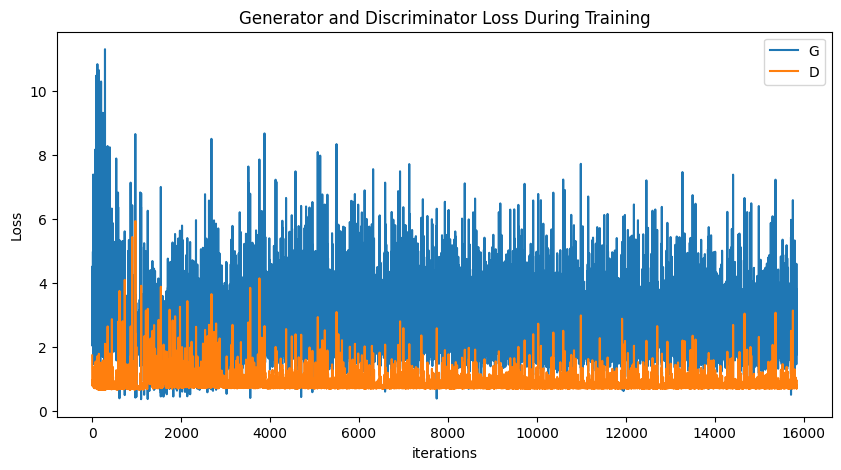

In [13]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

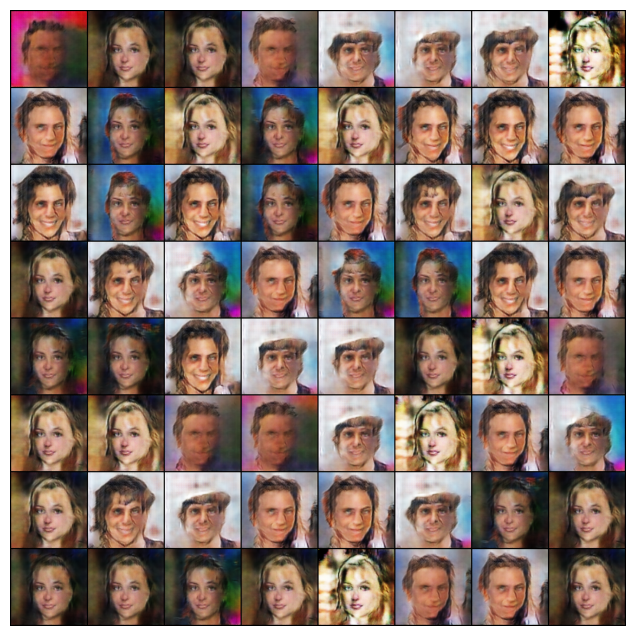

In [14]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())